<a href="https://colab.research.google.com/github/Camilacat05/Analise-de-dados-e-Visao-Computacional/blob/main/Train_Mask_RCNN_(DEMO)(2)of.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **1. Installation**

Load your dataset

In [ ]:
%tensorflow_version 1.x
!pip install --upgrade h5py==2.10.0
!wget https://pysource.com/extra_files/Mask_RCNN_basic_1.zip
!unzip Mask_RCNN_basic_1.zip
import sys
sys.path.append("/content/Mask_RCNN/mrcnn")
from m_rcnn import *
%matplotlib inline

TensorFlow 1.x selected.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.9 MB 12.6 MB/s 
  Attempting uninstall: h5py
    Found existing installation: h5py 3.1.0
    Uninstalling h5py-3.1.0:
      Successfully uninstalled h5py-3.1.0
--2022-06-08 21:43:20--  https://pysource.com/extra_files/Mask_RCNN_basic_1.zip
Resolving pysource.com (pysource.com)... 188.114.96.2, 188.114.97.2, 2a06:98c1:3120::2, ...
Connecting to pysource.com (pysource.com)|188.114.96.2|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1282557 (1.2M) [application/zip]
Saving to: ‘Mask_RCNN_basic_1.zip’

Mask_RCNN_basic_1.z 100%[===================>]   1.22M  --.-KB/s    in 0.07s   

2022-06-08 21:43:20 (16.7 MB/s) - ‘Mask_RCNN_basic_1.zip’ saved [1282557/1282557]

Archive:  Mask_RCNN_basic_1.zip
   creating: Mask_RCNN/
  inflating: Mask_RCNN/.gitignore    
   creating: Mask_RCNN/assets/
   creating: Ma

Using TensorFlow backend.


... done downloading pretrained model!


In [ ]:

#!nvidia-smi

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Wed Jun  8 21:43:34 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## **2. Image Dataset**

Load your annotated dataset


In [ ]:
# Extract Images

images_path = "all_img_18.zip"
#images_path = "img.zip"
#images_path = "train.zip"

#annotations_path = "/content/coco-17train.json"
#annotations_path = "/content/_annotations.coco.json"
annotations_path = "/content/coco-18train.json"

#extract_images(os.path.join("/content/",images_path), "/content/test")

extract_images(os.path.join("/content/",images_path), "/content/test_18")

Extracted: 30 images


In [ ]:
def load_image_dataset(annotation_path, dataset_path, dataset_type):
    dataset_train = CustomDataset()
    dataset_train.load_custom(annotation_path, dataset_path, dataset_type)
    dataset_train.prepare()
    return dataset_train, dataset_path

In [ ]:
dataset_val.image_info

[{'annotations': [{'area': 15137,
    'bbox': [139, 236, 244, 142],
    'category_id': 1,
    'id': 1,
    'image_id': 1,
    'iscrowd': 0,
    'segmentation': [[161,
      303,
      152,
      310,
      145,
      319,
      141,
      326,
      139,
      335,
      138,
      347,
      138,
      355,
      138,
      361,
      143,
      367,
      149,
      371,
      160,
      373,
      168,
      373,
      182,
      373,
      189,
      370,
      195,
      365,
      200,
      359,
      204,
      353,
      209,
      348,
      215,
      341,
      218,
      337,
      221,
      329,
      224,
      324,
      224,
      319,
      225,
      314,
      226,
      308,
      229,
      303,
      232,
      300,
      237,
      295,
      239,
      291,
      243,
      289,
      249,
      287,
      256,
      286,
      263,
      286,
      270,
      289,
      277,
      293,
      283,
      297,
      286,
      302,
      287,
      308,
      28

In [ ]:
dataset_train, path = load_image_dataset(os.path.join("/content/", annotations_path), "/content/test", "train")
dataset_val, path = load_image_dataset(os.path.join("/content/", annotations_path), "/content/test", "val")
class_number = dataset_train.count_classes()
print('Train: %d' % len(dataset_train.image_ids))
print('Validation: %d' % len(dataset_val.image_ids))
print("Classes: {}".format(class_number))

Annotation json path:  /content/_annotations.coco.json
Annotation json path:  /content/_annotations.coco.json
Train: 762
Validation: 95
Classes: 1


In [ ]:
dataset_val, path = load_image_dataset(os.path.join("/content/", annotations_path), "/content/test_18", "val")
print('Validation: %d' % len(dataset_val.image_ids))

Annotation json path:  /content/coco-18train.json
Validation: 3


In [ ]:
path

'/content/test'

In [ ]:
# Load image samples
#display_image_samples(dataset_train)

##**3. Training**

Train Mask RCNN on your custom Dataset.

In [ ]:
# Load Configuration
config = CustomConfig(class_number)
config.display()
model = load_training_model(config)


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     4
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.9
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 4
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  512
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  512
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [512 512   3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE             

In [ ]:
# Start Training
# This operation might take a long time.
train_head(model, dataset_train, dataset_train, config)


Starting at epoch 0. LR=0.001

Checkpoint Path: /content/Mask_RCNN/logs/object20220608T2144/mask_rcnn_object_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv4       (TimeDistributed)
mrcnn_mask_bn

## **4. Detection (test your model on a random image)**

In [ ]:
# Load Test Model
# The latest trained model will be loaded
test_model, inference_config = load_test_model(class_number)



Instructions for updating:
Use `tf.cast` instead.
Loading weights from  /content/Mask_RCNN/logs/object20220608T2144/mask_rcnn_object_0005.h5
Re-starting from epoch 5


original_image           shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
Trained model result
Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max:  512.00000  int64
anchors                  shape: (1, 65472, 4)         min:   -0.70849  max:    1.58325  float32
Annotation


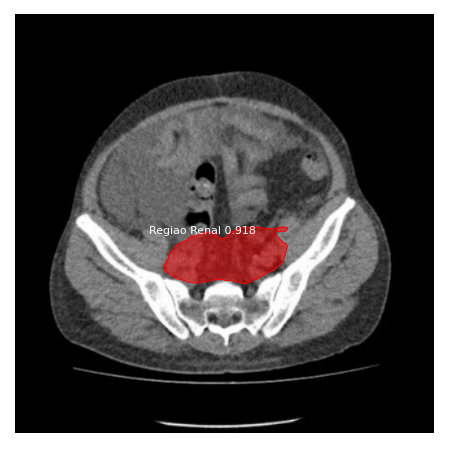

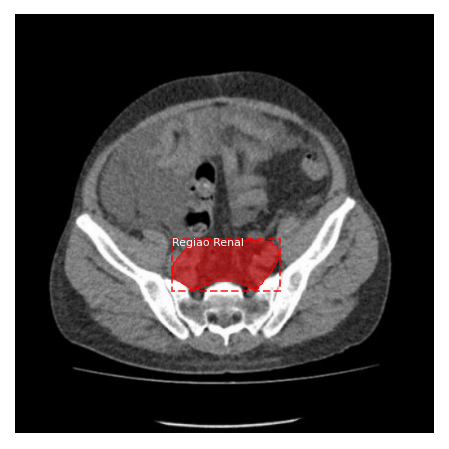

In [ ]:
# Test on a random image
test_random_image(test_model, dataset_val, inference_config)



In [ ]:
 # result = []
  #image_ids = np.random.choice(dataset_train.image_ids, 4)
  
  #for image_id in image_ids:
  #  image = dataset_train.load_image(image_id)
  #  mask, class_ids = dataset_train.load_mask(image_id)
  #  visualize.display_top_masks(image, mask, class_ids, dataset_train.class_names)
  #  r = test_random_image(test_model, dataset_train, inference_config)
  #  result.append(r)

Trained model result
Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max:  512.00000  int64
anchors                  shape: (1, 65472, 4)         min:   -0.70849  max:    1.58325  float32
0
Trained model result
Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max:  512.00000  int64
anchors                  shape: (1, 65472, 4)         min:   -0.70849  max:    1.58325  float32
1
Trained model result
Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
molded_images      

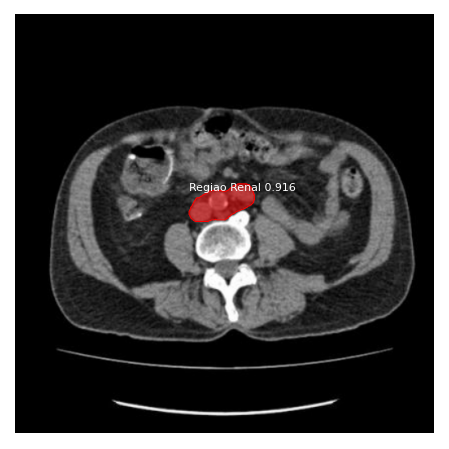

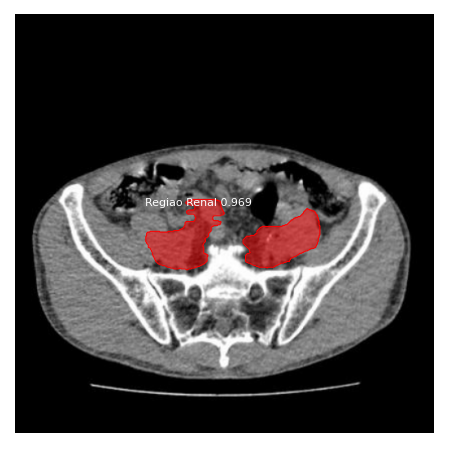

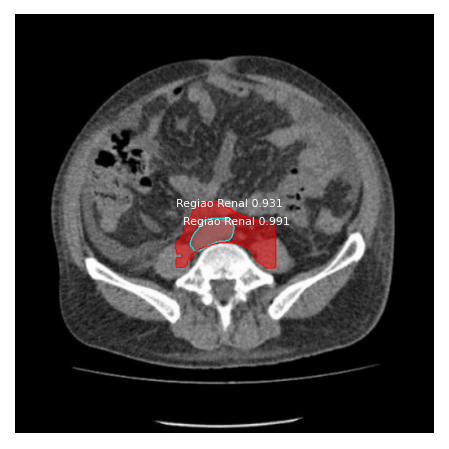

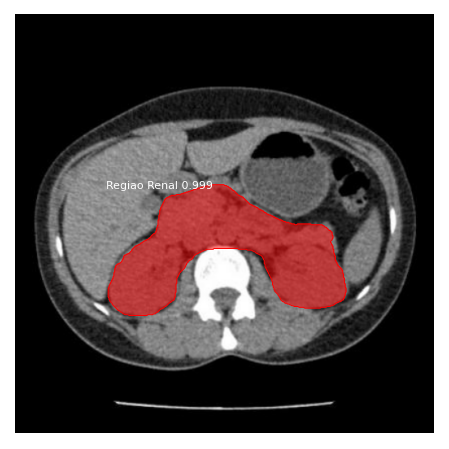

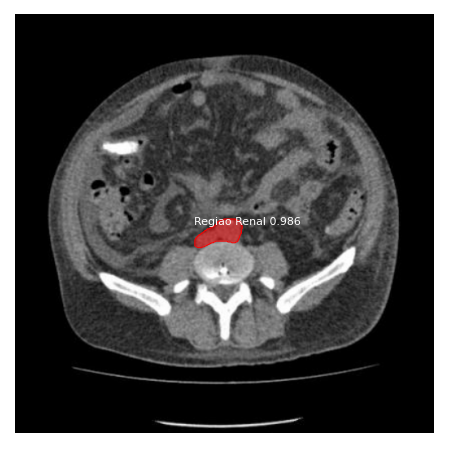

...

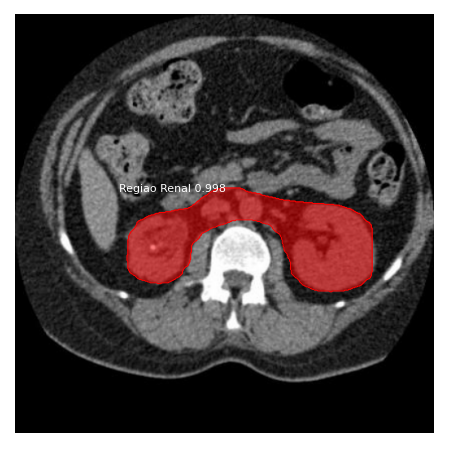

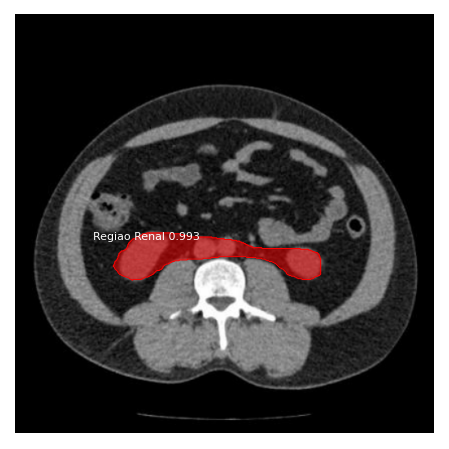

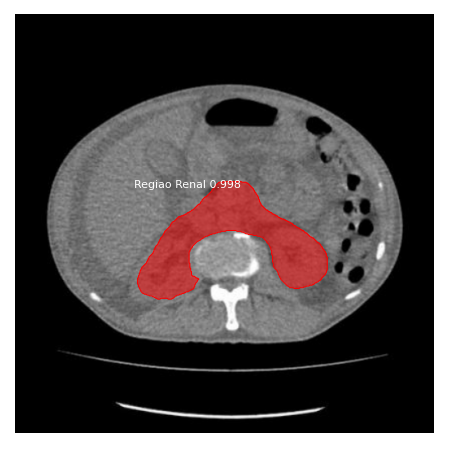

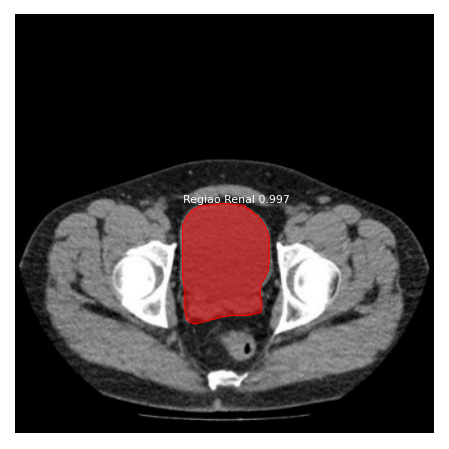

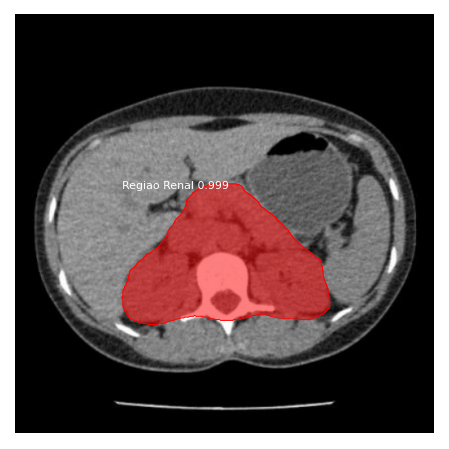

In [ ]:
#Testando no Conjunto de Treino
from pathlib import Path

result1 = []

image_ids = dataset_train.image_ids
for image_id in image_ids:
      #image_id = random.choice(dataset_train.image_ids)
      original_image, image_meta, gt_class_id, gt_bbox, gt_mask = \
      modellib.load_image_gt(dataset_train, inference_config,
                               image_id, use_mini_mask=False)

     #log("original_image", original_image)
    # log("image_meta", image_meta)
    # log("gt_class_id", gt_class_id)
     #log("gt_bbox", gt_bbox)
      #log("gt_mask", gt_mask)
      #result.append(gt_mask)
     

    # Model result
      print("Trained model result")
      results = test_model.detect([original_image], verbose=1)
      r = results[0]
      result1.append(r['masks'])
     
      
      visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'],
                                dataset_train.class_names, r['scores'], ax=get_ax(), show_bbox=False)
      print(dataset_train.image_ids[image_id])

      #print("Annotation")
      #visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id,
                                #dataset_train.class_names, figsize=(8, 8))
     


Trained model result
Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max:  512.00000  int64
anchors                  shape: (1, 65472, 4)         min:   -0.70849  max:    1.58325  float32
Trained model result
Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 512, 512, 3)      min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max:  512.00000  int64
anchors                  shape: (1, 65472, 4)         min:   -0.70849  max:    1.58325  float32
Trained model result
Processing 1 images
image                    shape: (512, 512, 3)         min:    0.00000  max:  255.00000  uint8
molded_images          

KeyboardInterrupt: ignored

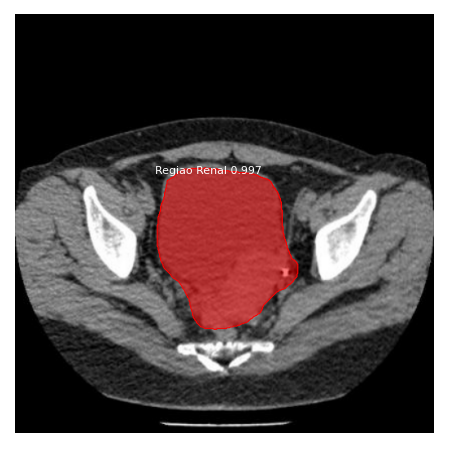

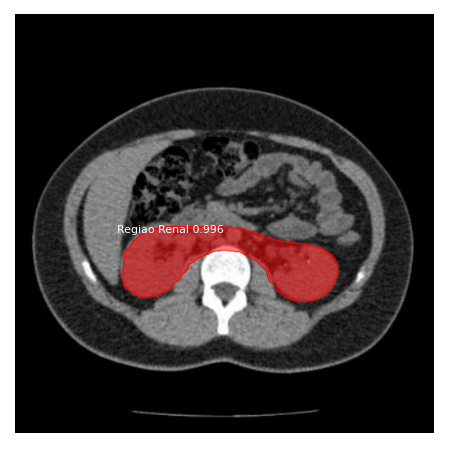

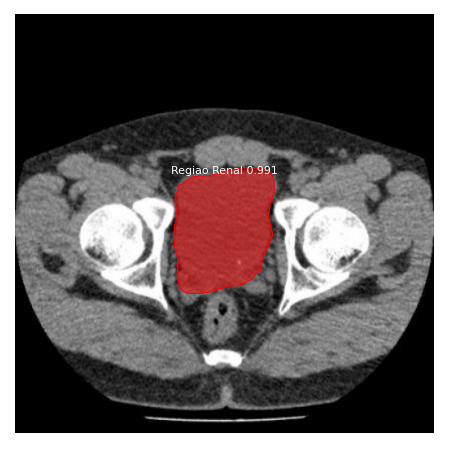

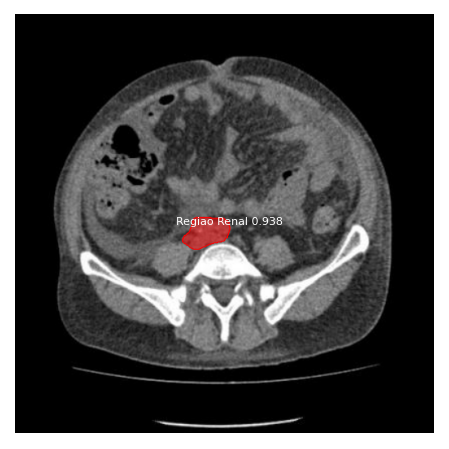

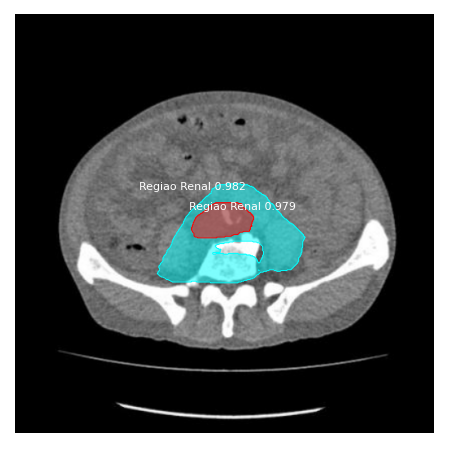

...

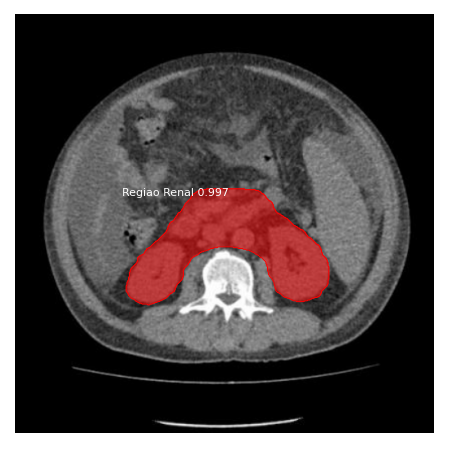

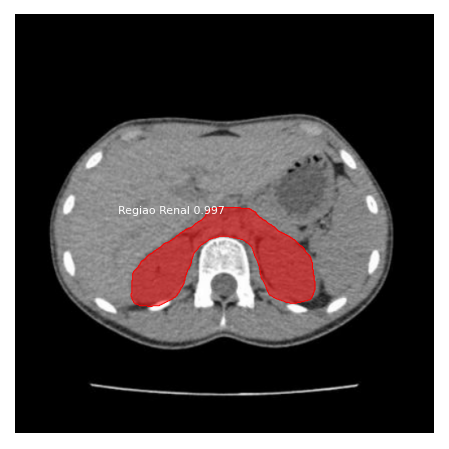

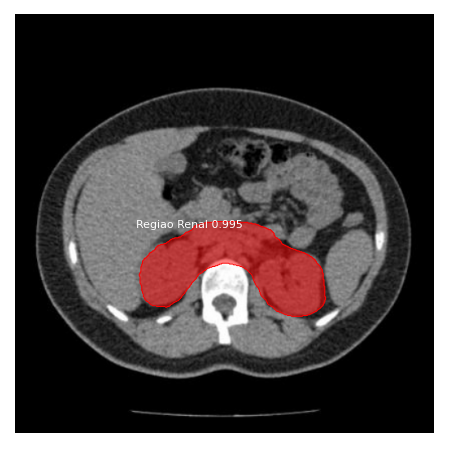

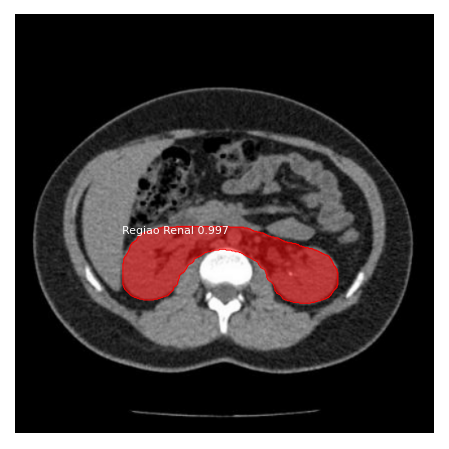

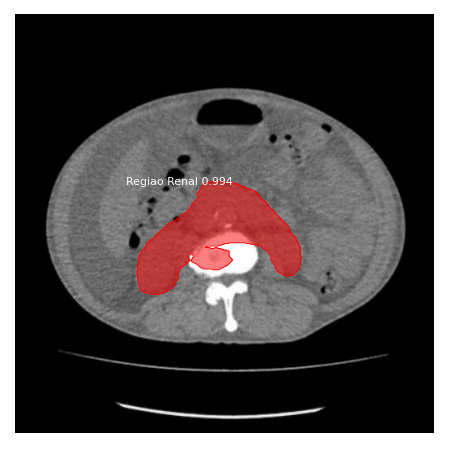

In [ ]:
#Testando no conjunto de validação 
from pathlib import Path
result1 = []

image_ids = dataset_train.image_ids
for image_id in image_ids:
      #image_id = random.choice(dataset_train.image_ids)
      original_image, image_meta, gt_class_id, gt_bbox, gt_mask = \
      modellib.load_image_gt(dataset_train, inference_config,
                               image_id, use_mini_mask=False)

     #log("original_image", original_image)
    # log("image_meta", image_meta)
    # log("gt_class_id", gt_class_id)
     #log("gt_bbox", gt_bbox)
      #log("gt_mask", gt_mask)
      #result.append(gt_mask)
     
      try:
    # Model result
        print("Trained model result")
        results = test_model.detect([original_image], verbose=1)
        r = results[0]
        result1.append(r['masks'])
     
     
        visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'],
                               dataset_train.class_names, r['scores'], ax=get_ax(), show_bbox=False)
      except:
        print(dataset_train.image_ids[image_id])

      #print("Annotation")
      #visualize.display_instances(original_image, gt_bbox, gt_mask, gt_class_id,
                                #dataset_train.class_names, figsize=(8, 8))
     


In [ ]:

len(result1)
result1[0].shape



(512, 512, 1)

In [ ]:
rt = []
rt1 = []
cont= 0
for i in result1:
  try:
    img = i[:,:,:1]
    cont+=1
    rt.append(img)
    print(len(rt))
  except:
    datas = np.array([i], order='C')
    datas.resize((512,512))
    datas.shape
    rt1.append(datas)




1
2
3


In [ ]:
##código oficial 

import numpy as np
import matplotlib.pyplot as plt

cont = 0
for i in rt:
  try:
      plt.imsave("img"+ str(cont) + ".png", np.reshape(i,(512,512)).astype(np.uint8)) 
      cont+=1
  
  except:
      print(i)
  
 
 

In [ ]:
!zip -m maskr-cnn-18-2.zip ./*.png

  adding: img0.png (deflated 47%)
  adding: img1.png (deflated 48%)
  adding: img2.png (deflated 49%)


In [ ]:
#Não utilizo
list_m = []
for i in result1:
  u = (np.reshape(i,(512,512)).astype(np.uint8))
  list_m.append(u)


In [ ]:
#binariza as máscaras que estão em valor bool
mask = r['masks']
mask = mask.astype(int)
mask.shape


**Tentativas


In [ ]:
len(mask)

In [ ]:
#mask.shape

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
for i in result1:
  plt.imshow(np.reshape(i,(512,512)).astype(np.uint8),cmap='gray')



In [ ]:
plt.imsave("mask.png", np.reshape(result1[0],(512,512)).astype(np.uint8))

In [ ]:
cont = 0
for i in result1:
  plt.imsave("img"+ str(cont) + ".png", np.reshape(i,(512,512)).astype(np.uint8))
  cont+=1
